In [176]:
import os
import re
import datetime
import random
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx
import matplotlib.colors as mcolors
from pyvis.network import Network
from holoviews import opts
from enum import Enum
%matplotlib inline

In [177]:
DIR_PATH = r'E:\faks\Рударење на масивни податоци\AIOps挑战赛数据'
DATE_PATTERN = r'[0-9]{4}_[0-9]{2}_[0-9]{2}'


In [178]:
class DataSource(Enum):
    ESB = 1
    KPI = 2
    TRACE = 3

In [179]:
CN_TO_EN_MAP = {
    '业务指标' : DataSource.ESB,
    '平台指标' :  DataSource.KPI,
    '调用链指标' : DataSource.TRACE
}

EN_TO_CN_MAP = dict((v, k) for k, v in CN_TO_EN_MAP.items())
data = {}

In [180]:
def extract_dates_from_paths():
    return [folder for folder in os.listdir(DIR_PATH) if re.match(DATE_PATTERN, folder)]

In [181]:
def extract_folder_paths(src: DataSource) -> list[str]:
    return  ["\\".join([DIR_PATH, folder, EN_TO_CN_MAP[src]]) for folder in extract_dates_from_paths()]


In [182]:
def extract_file_paths(src: DataSource) -> list[str]:
    return [["\\".join([folder, file]) for file in os.listdir(folder)] for folder in extract_folder_paths(src)]

In [183]:
def rename_columns(df: pd.DataFrame, src: DataSource) -> pd.DataFrame:
    if src == DataSource.ESB:
        return df.rename(columns = {'serviceName' : 'service_name', 
                                            'startTime' : 'start_time',
                                            'avg_time' : 'average_call_time',
                                            'num' : 'total_number_of_calls',
                                            'succee_num' : 'number_of_successful_calls',
                                            'succee_rate' : 'successful_call_rate'})
        
    elif src == DataSource.KPI:
        return df.rename(columns={'itemid' : 'item_id',
                                         'cmdb_id' : 'host_id',
                                         'name' : 'kpi_metric_name',
                                         'value' : 'kpi_metric_value'})
    else:
        return df.rename(columns={'callType' :'call_type',
                                         'startTime': 'start_time',
                                         'elapsedTime': 'elapsed_time',
                                         'traceId' : 'trace_id',
                                         'serviceName' : 'service_name',
                                         'dsName': 'data_source_name'})

In [184]:
def preprocess(df: pd.DataFrame, src: DataSource) -> pd.DataFrame:

    df = rename_columns(df, src)

    if src != DataSource.KPI :
        df.set_index('start_time', inplace=True)
    
    else:
       df.set_index('timestamp', inplace=True)

    df.index = pd.to_datetime(df.index, unit='ms')

    return df
    

In [185]:
data = {date: {DataSource.ESB: pd.DataFrame(),
               DataSource.KPI: {},
               DataSource.TRACE: {}} for date in extract_dates_from_paths()}
# date -> {
# ESB -> esb.csv
# KPI -> {mw_redis: mw_redis.csv, os_linux: os_linux.csv ...}
# TRACE -> {trace_osb: trace_osb.csv, trace_local: trace_local.csv ...}
# } 

In [186]:
def extract_name(path:str) -> str:
    return path.split("\\")[-1].split(".")[0]

In [187]:
def extract_host_names() -> set:
    return set([extract_name(path) for path in  sum(extract_file_paths(DataSource.KPI), [])])

In [188]:
def extract_trace_names() -> set:
    return set([extract_name(path) for path in sum(extract_file_paths(DataSource.TRACE), [])])

In [1]:
extract_file_paths(DataSource.TRACE)

NameError: name 'extract_file_paths' is not defined

In [189]:
print(extract_host_names())
print(extract_trace_names())

{'dcos_docker', 'db_oracle_11g', 'dcos_container', 'os_linux', 'mw_redis'}
{'trace_osb', 'trace_local', 'trace_csf', 'trace_fly_remote', 'trace_remote_process', 'trace_jdbc'}


In [190]:
def populate_dataset_dict() -> None:
  print("Populating data dictionary...")
  for esb_path, kpi_paths, trace_paths, date in zip(sum(extract_file_paths(DataSource.ESB), []), 
                                                    extract_file_paths(DataSource.KPI), 
                                                    extract_file_paths(DataSource.TRACE), 
                                                    extract_dates_from_paths()):
      
      print(f"Inserting {date}...")
        
      data[date][DataSource.ESB] = preprocess(pd.read_csv(esb_path), DataSource.ESB)

      print("ESB insertion completed!")
  
      data[date][DataSource.KPI] = {
         extract_name(kpi_path) : preprocess(pd.read_csv(kpi_path), DataSource.KPI) for kpi_path in kpi_paths
        } 

      print("KPI insertion completed!")

      data[date][DataSource.TRACE] = {
          extract_name(trace_path) : preprocess(pd.read_csv(trace_path), DataSource.TRACE) for trace_path in trace_paths
        }
      
      print("TRACE insertion completed!")
      #TODO Remove break operation
      break
  print("Data dictionary populated successfully!")
        

In [191]:
populate_dataset_dict()

Populating data dictionary...
Inserting 2020_04_11...
ESB insertion completed!
KPI insertion completed!
TRACE insertion completed!
Data dictionary populated successfully!


In [192]:
def concatenate_files(src: DataSource) -> pd.DataFrame:
    file_paths = sum(extract_file_paths(src), [])
    df = pd.concat([preprocess(pd.read_csv(path), src) for path in file_paths])
    return df

# Business Metrics

## Preprocessing

### Load datasets

In [193]:
df_esb = concatenate_files(DataSource.ESB)
df_esb

,service_name,average_call_time,total_number_of_calls,number_of_successful_calls,successful_call_rate
start_time,,,,,
2020-04-10 16:00:00,osb_001,0.3330,1,1,1.0
2020-04-10 16:00:00,osb_001,0.5869,360,360,1.0
2020-04-10 16:01:00,osb_001,0.5497,343,343,1.0
2020-04-10 16:02:00,osb_001,0.6091,359,359,1.0
2020-04-10 16:03:00,osb_001,0.5231,359,359,1.0
...,...,...,...,...,...
2020-05-30 21:55:00,osb_001,0.4647,613,613,1.0
2020-05-30 21:56:00,osb_001,0.4547,548,548,1.0
2020-05-30 21:57:00,osb_001,0.4854,480,480,1.0


### Check for missing values or extraneous attributes/columns

In [194]:
df_esb.isnull().sum()

service_name                  0
average_call_time             0
total_number_of_calls         0
number_of_successful_calls    0
successful_call_rate          0
dtype: int64

In [195]:
df_esb['service_name'].value_counts()

osb_001    5926
Name: service_name, dtype: int64

In [196]:
df_esb.drop('service_name', axis=1, inplace=True)

In [197]:
def filter_anomalies_by_successful_call_rate(df):
    return df[df['successful_call_rate'] == 1], df[df['successful_call_rate'] < 1]

## EDA

### Data types and summary statistics

In [198]:
df_esb.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5926 entries, 2020-04-10 16:00:00 to 2020-05-30 21:59:00
Data columns (total 4 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   average_call_time           5926 non-null   float64
 1   total_number_of_calls       5926 non-null   int64  
 2   number_of_successful_calls  5926 non-null   int64  
 3   successful_call_rate        5926 non-null   float64
dtypes: float64(2), int64(2)
memory usage: 231.5 KB


In [199]:
df_esb.describe()

,average_call_time,total_number_of_calls,number_of_successful_calls,successful_call_rate
count,5926.000000,5926.000000,5926.000000,5926.000000
mean,5.744434,428.132467,422.853864,0.970396
std,42.189797,178.349202,182.019518,0.151411
min,0.000000,1.000000,0.000000,0.000000
25%,0.515950,403.000000,399.000000,1.000000
50%,0.597150,473.000000,470.000000,1.000000
75%,0.734200,549.000000,548.000000,1.000000
max,800.120400,1157.000000,1155.000000,1.000000


In [200]:
df_successful_calls, df_unsuccessful_calls = filter_anomalies_by_successful_call_rate(df_esb)

In [201]:
df_successful_calls.describe()

,average_call_time,total_number_of_calls,number_of_successful_calls,successful_call_rate
count,5468.000000,5468.000000,5468.000000,5468.0
mean,3.154770,445.895026,445.895026,1.0
std,21.193184,158.419445,158.419445,0.0
min,0.333000,1.000000,1.000000,1.0
25%,0.516800,415.750000,415.750000,1.0
50%,0.593900,481.000000,481.000000,1.0
75%,0.690425,552.000000,552.000000,1.0
max,666.788500,652.000000,652.000000,1.0


In [202]:
df_unsuccessful_calls.describe()

,average_call_time,total_number_of_calls,number_of_successful_calls,successful_call_rate
count,458.000000,458.000000,458.000000,458.000000
mean,36.662078,216.067686,147.768559,0.616959
std,129.097132,251.642695,217.089105,0.401931
min,0.000000,1.000000,0.000000,0.000000
25%,0.396750,9.000000,1.000000,0.132275
50%,1.083200,120.500000,35.500000,0.792450
75%,6.286850,423.500000,224.750000,0.978025
max,800.120400,1157.000000,1155.000000,0.999000


In [203]:
df_esb.corr()

,average_call_time,total_number_of_calls,number_of_successful_calls,successful_call_rate
average_call_time,1.000000,-0.284451,-0.276161,-0.185014
total_number_of_calls,-0.284451,1.000000,0.967397,0.273926
number_of_successful_calls,-0.276161,0.967397,1.000000,0.417784
successful_call_rate,-0.185014,0.273926,0.417784,1.000000


### Plot data

<AxesSubplot:>

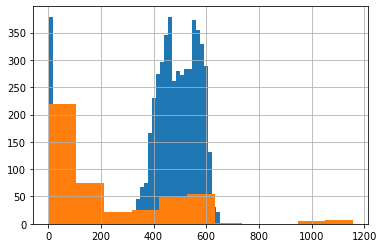

In [204]:
df_successful_calls['total_number_of_calls'].hist(bins='auto')
df_unsuccessful_calls['total_number_of_calls'].hist(bins='auto')


<AxesSubplot:>

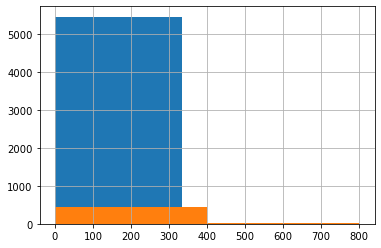

In [205]:
df_successful_calls['average_call_time'].hist(bins=2)
df_unsuccessful_calls['average_call_time'].hist(bins=2)

#### Concatenated business metrics datasets

# Infrastructure metrics

## Preprocessing

### Load Datasets

In [206]:
df_kpi = concatenate_files(DataSource.KPI)
df_kpi

,item_id,kpi_metric_name,bomc_id,kpi_metric_value,host_id
timestamp,,,,,
2020-04-10 16:04:54,999999998650974,MEM_Total,ZJ-002-055,381.902264,db_003
2020-04-10 16:04:34,999999996512734,MEM_real_util,ZJ-002-053,57.320000,db_011
2020-04-10 16:04:23,63151604,Sess_Connect,ZJ-002-012,396.000000,db_005
2020-04-10 16:04:23,63149004,DbTime,ZJ-002-020,9.500000,db_010
2020-04-10 16:03:54,999999998650974,MEM_Total,ZJ-002-055,381.902264,db_003
...,...,...,...,...,...
2020-05-30 21:59:59,65432039,Disk_io_util,ZJ-001-125,0.000000,os_010
2020-05-30 21:59:59,999999996432239,Disk_rd_kbs,ZJ-001-099,0.000000,os_007
2020-05-30 21:59:59,999999996431279,CPU_system_time,ZJ-001-014,0.130679,os_013


### Rename columns, convert timestamp to datetime, set dataframe index

In [207]:
df_kpi.isnull().sum()

item_id                 0
kpi_metric_name         0
bomc_id             34702
kpi_metric_value        0
host_id                 0
dtype: int64

In [208]:
df_kpi.groupby('host_id').value_counts()

host_id        item_id          kpi_metric_name             bomc_id     kpi_metric_value
container_001  999999996470837  container_fail_percent      ZJ-004-065  0.000000e+00        5313
container_002  999999996470922  container_fail_percent      ZJ-004-065  0.000000e+00        5311
db_001         999999998650674  MEM_Total                   ZJ-002-055  3.819023e+02        5339
               999999998650698  Row_Lock                    ZJ-002-023  0.000000e+00        5338
               999999998650710  Hang                        ZJ-002-029  1.000000e+00        5337
                                                                                            ... 
redis_012      999999996508250  total_connections_received  ZJ-005-031  2.169071e+07           1
                                                                        2.169071e+07           1
                                                                        2.169071e+07           1
                                      

In [209]:
host_names = dict(tuple(df_kpi.groupby(['host_id', 'bomc_id', 'kpi_metric_name'])))
host_names

{('container_001',
  'ZJ-004-065',
  'container_fail_percent'):                              item_id         kpi_metric_name     bomc_id  \
 timestamp                                                                  
 2020-04-10 16:00:43  999999996470837  container_fail_percent  ZJ-004-065   
 2020-04-10 16:01:42  999999996470837  container_fail_percent  ZJ-004-065   
 2020-04-10 16:02:48  999999996470837  container_fail_percent  ZJ-004-065   
 2020-04-10 16:03:42  999999996470837  container_fail_percent  ZJ-004-065   
 2020-04-10 16:04:41  999999996470837  container_fail_percent  ZJ-004-065   
 ...                              ...                     ...         ...   
 2020-05-30 21:55:55  999999996470837  container_fail_percent  ZJ-004-065   
 2020-05-30 21:56:55  999999996470837  container_fail_percent  ZJ-004-065   
 2020-05-30 21:57:54  999999996470837  container_fail_percent  ZJ-004-065   
 2020-05-30 21:58:55  999999996470837  container_fail_percent  ZJ-004-065   
 2020-05-30 2

In [210]:
len(host_names.keys())

2080

In [211]:
host_names.keys()

dict_keys([('container_001', 'ZJ-004-065', 'container_fail_percent'), ('container_002', 'ZJ-004-065', 'container_fail_percent'), ('db_001', 'ZJ-002-001', 'Tbs_Used_Pct'), ('db_001', 'ZJ-002-002', 'Tbs_Free_Gb'), ('db_001', 'ZJ-002-004', 'Sess_Used_Temp'), ('db_001', 'ZJ-002-005', 'UndoTbs_Pct'), ('db_001', 'ZJ-002-006', 'Sess_Used_Undo'), ('db_001', 'ZJ-002-007', 'DbFile_Used_Pct'), ('db_001', 'ZJ-002-009', 'ACS'), ('db_001', 'ZJ-002-010', 'AIOS'), ('db_001', 'ZJ-002-011', 'AWS'), ('db_001', 'ZJ-002-012', 'Sess_Connect'), ('db_001', 'ZJ-002-013', 'Sess_Active'), ('db_001', 'ZJ-002-014', 'TPS_Per_Sec'), ('db_001', 'ZJ-002-015', 'Exec_Per_Sec'), ('db_001', 'ZJ-002-016', 'Call_Per_Sec'), ('db_001', 'ZJ-002-017', 'Login_Per_Sec'), ('db_001', 'ZJ-002-018', 'Logic_Read_Per_Sec'), ('db_001', 'ZJ-002-019', 'Physical_Read_Per_Sec'), ('db_001', 'ZJ-002-020', 'DbTime'), ('db_001', 'ZJ-002-021', 'User_Commit'), ('db_001', 'ZJ-002-022', 'Redo_Per_Sec'), ('db_001', 'ZJ-002-023', 'Row_Lock'), ('db_00

# Traces

In [212]:
def group_traces_by_trace_id(date: str):
    result = pd.DataFrame()
    for _, df  in data[date][DataSource.TRACE].items():
        result = pd.concat([result, df])
    return list(result.sort_index(ascending=True).groupby('trace_id'))

In [213]:
df_traces = group_traces_by_trace_id('2020_04_11')
df_traces

[('00001171657d3a491126',
                               call_type  elapsed_time  success  \
  start_time                                                      
  2020-04-10 19:07:17.961            OSB         202.0     True   
  2020-04-10 19:07:17.968            CSF         186.0     True   
  2020-04-10 19:07:17.972  RemoteProcess         181.0     True   
  2020-04-10 19:07:17.975      FlyRemote           5.0     True   
  2020-04-10 19:07:17.982            CSF          33.0     True   
  2020-04-10 19:07:17.984  RemoteProcess          31.0     True   
  2020-04-10 19:07:18.003           JDBC           3.0     True   
  2020-04-10 19:07:18.003          LOCAL           6.0     True   
  2020-04-10 19:07:18.007           JDBC           2.0     True   
  2020-04-10 19:07:18.016            CSF          22.0     True   
  2020-04-10 19:07:18.018  RemoteProcess          19.0     True   
  2020-04-10 19:07:18.021           JDBC           3.0     True   
  2020-04-10 19:07:18.021          L

In [214]:
def extract_all_traces_from_date(date: str):
    return list(set([trace_id for df in  data[date][DataSource.TRACE].values()  for trace_id in df.trace_id.values]))


In [215]:
def find_root_node_from_trace(traces: pd.DataFrame):
    return traces.loc[traces.pid == 'None']


In [216]:
df_traces[0][1]

,call_type,elapsed_time,success,trace_id,id,pid,cmdb_id,service_name,data_source_name
start_time,,,,,,,,,
2020-04-10 19:07:17.961,OSB,202.0,True,00001171657d3a491126,888cc171657d3a491127,None,os_022,osb_001,NaN
2020-04-10 19:07:17.968,CSF,186.0,True,00001171657d3a491126,37e58171657d3a501129,888cc171657d3a491127,os_022,csf_001,NaN
2020-04-10 19:07:17.972,RemoteProcess,181.0,True,00001171657d3a491126,1879b171657d3a541451,37e58171657d3a501129,docker_001,csf_001,NaN
2020-04-10 19:07:17.975,FlyRemote,5.0,True,00001171657d3a491126,2421d171657d3a571453,1879b171657d3a541451,docker_001,fly_remote_001,NaN
2020-04-10 19:07:17.982,CSF,33.0,True,00001171657d3a491126,f97c2171657d3a5d1457,1879b171657d3a541451,docker_001,csf_002,NaN
2020-04-10 19:07:17.984,RemoteProcess,31.0,True,00001171657d3a491126,81ae2171657d3a608910,f97c2171657d3a5d1457,docker_008,csf_002,NaN
2020-04-10 19:07:18.003,JDBC,3.0,True,00001171657d3a491126,5b07b171657d3a738931,a17fc171657d3a738928,docker_008,NaN,db_003
2020-04-10 19:07:18.003,LOCAL,6.0,True,00001171657d3a491126,a17fc171657d3a738928,81ae2171657d3a608910,docker_008,local_method_011,db_003
2020-04-10 19:07:18.007,JDBC,2.0,True,00001171657d3a491126,a5bb0171657d3a778934,a17fc171657d3a738928,docker_008,NaN,db_003


### Trace to nx graph and pyvis network

Visualizing trace with trace_id 00001171657d3a491126 and 58 spans
Root:                         call_type  elapsed_time  success  \
start_time                                                 
2020-04-10 19:07:17.961       OSB         202.0     True   

                                     trace_id                    id   pid  \
start_time                                                                  
2020-04-10 19:07:17.961  00001171657d3a491126  888cc171657d3a491127  None   

                        cmdb_id service_name data_source_name  
start_time                                                     
2020-04-10 19:07:17.961  os_022      osb_001              NaN  
Trace start time: 2020-04-10T19:07:17.961000000
[(0.596078431372549, 0.3058823529411765, 0.6392156862745098, 1.0), (0.596078431372549, 0.3058823529411765, 0.6392156862745098, 1.0), (0.8941176470588236, 0.10196078431372549, 0.10980392156862745, 1.0), (0.8941176470588236, 0.10196078431372549, 0.10980392156862745, 1.0), (0.8

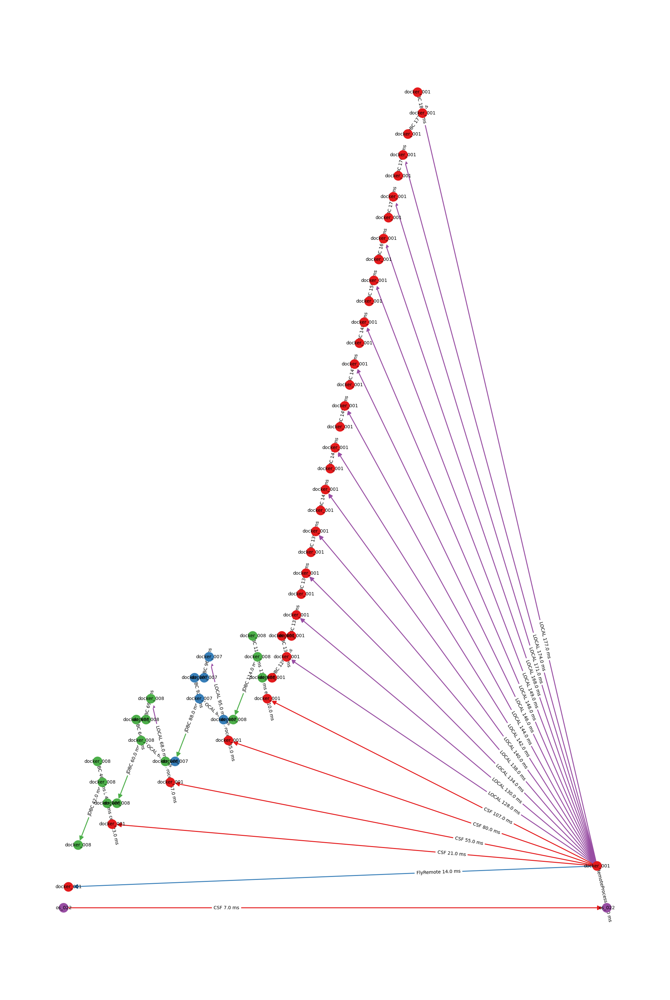

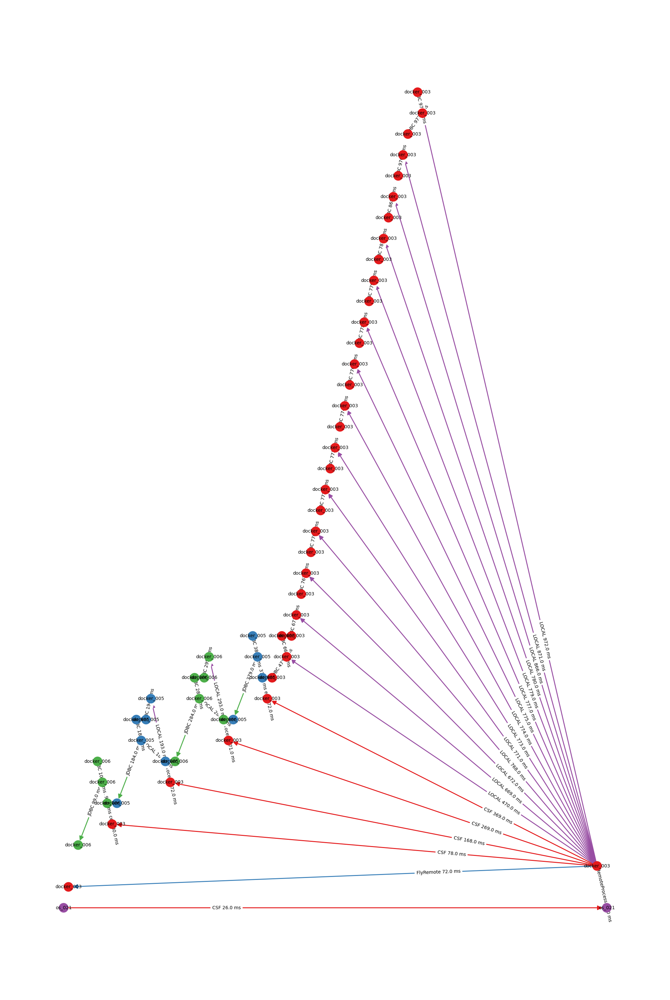

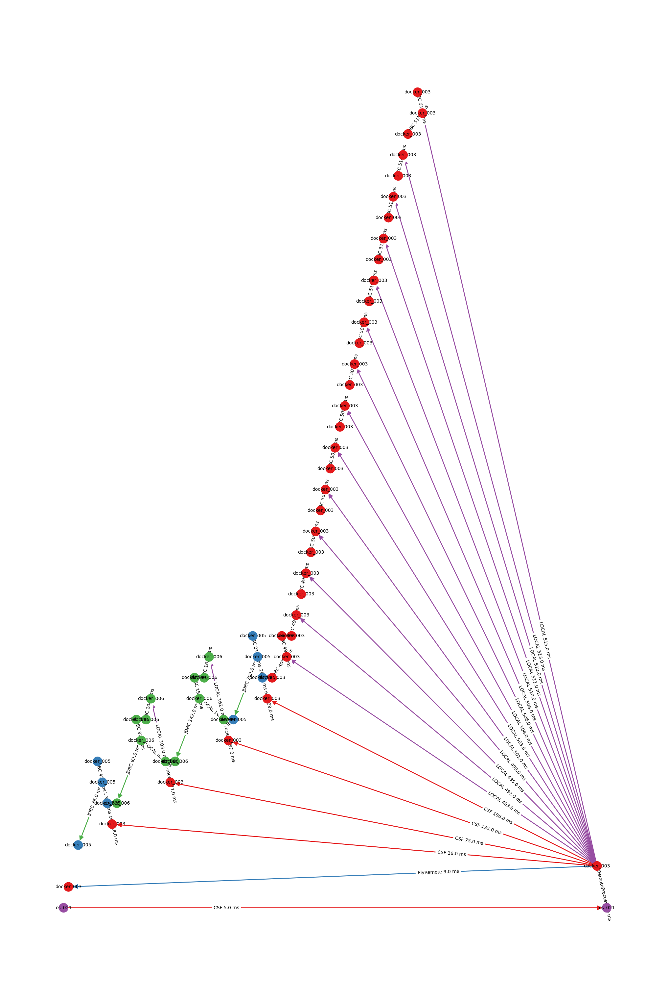

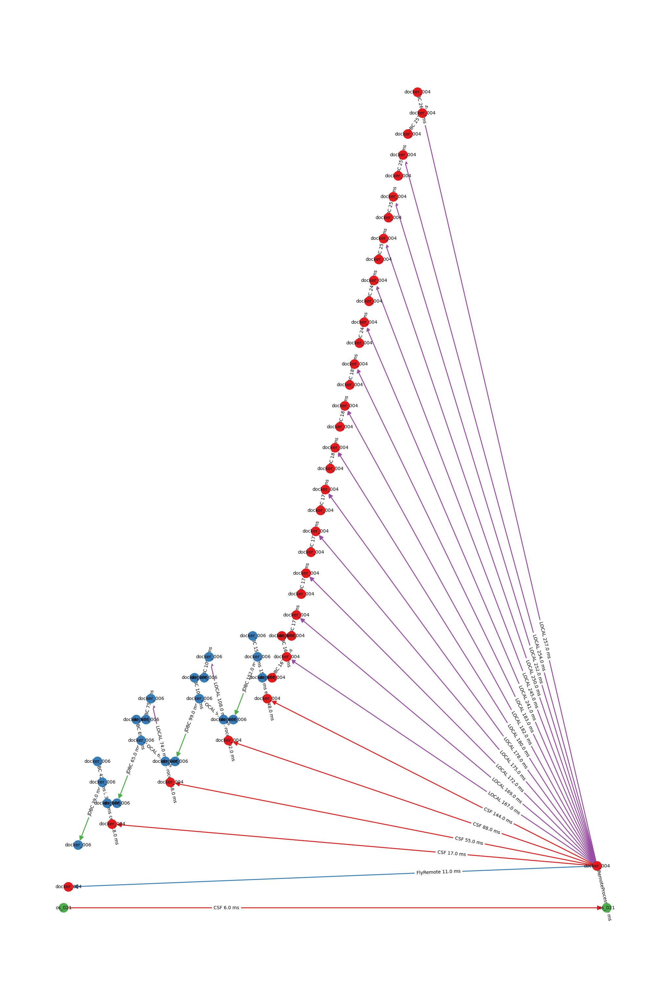

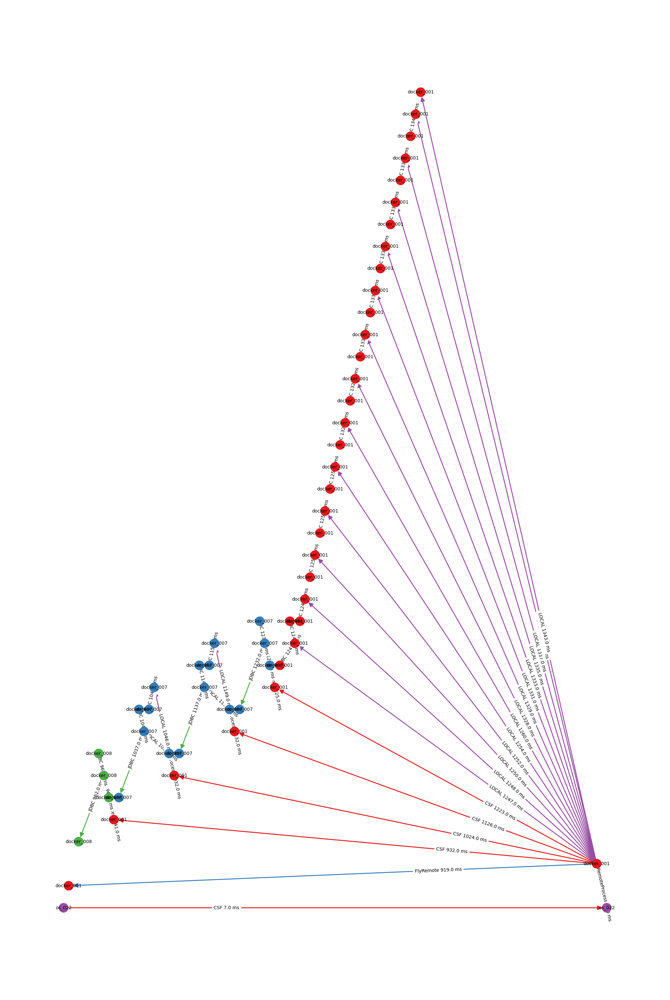

...

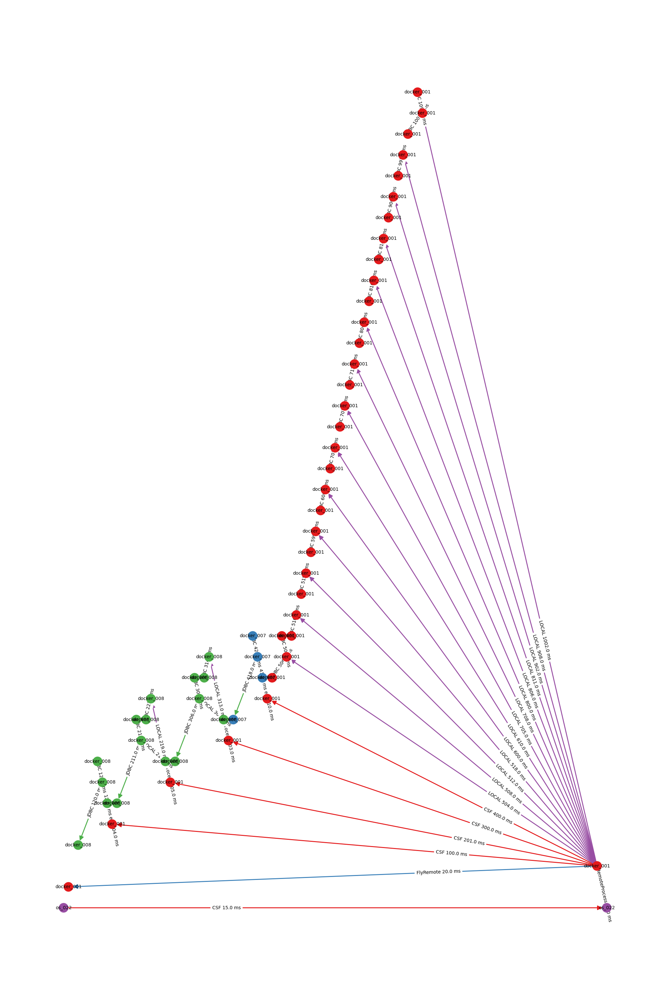

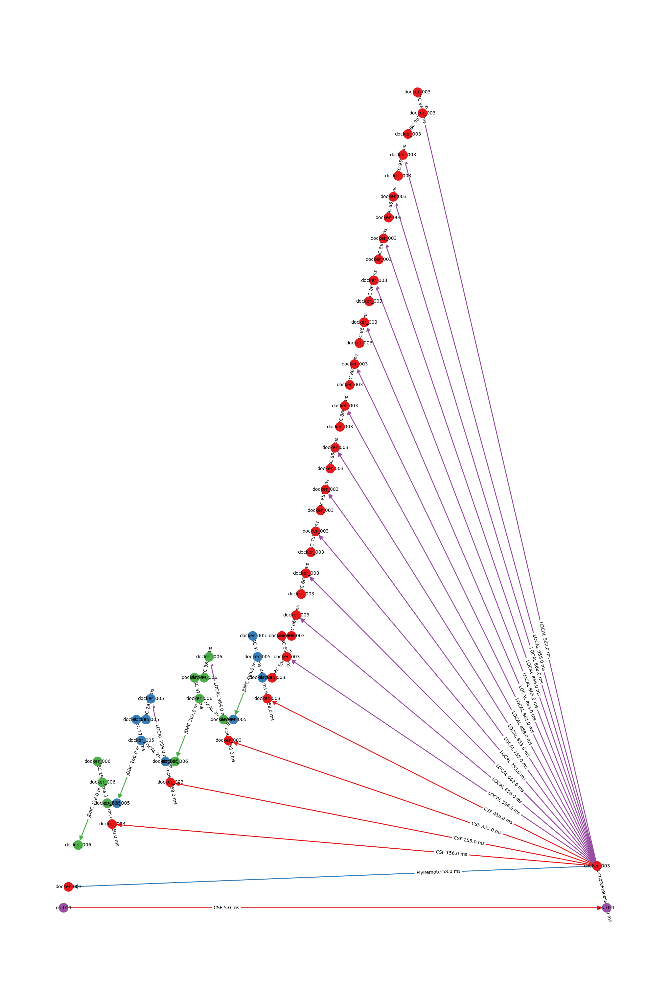

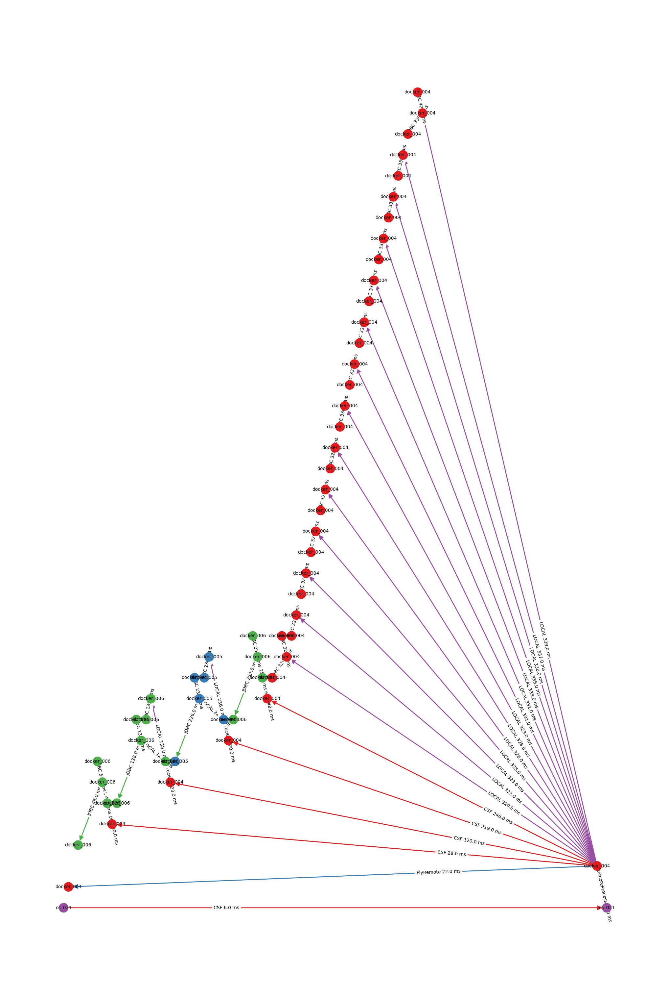

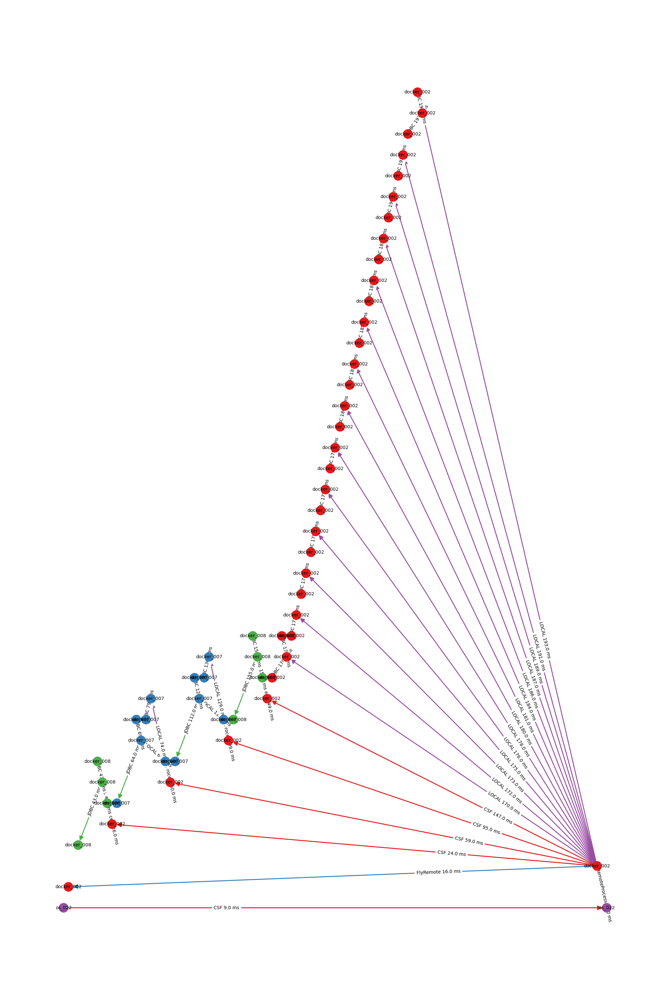

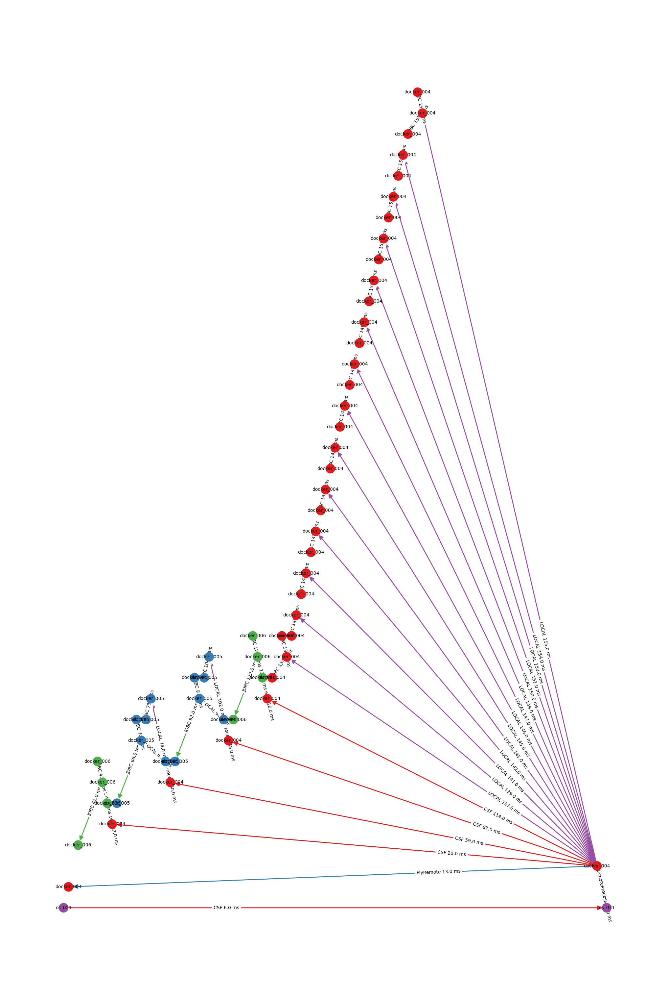

In [217]:

for trace_id, traces in  df_traces[:20]: #TODO remove [:20]

     print(f"Visualizing trace with trace_id {trace_id} and {len(traces)} spans")

     graph = nx.from_pandas_edgelist(traces, source='pid', target='id', create_using=nx.DiGraph(), edge_attr='call_type')

     graph.remove_node('None')
     pos = nx.planar_layout(graph)

     root, node_attributes, node_labels, edge_attributes, edge_labels = find_root_node_from_trace(traces), {}, {}, {}, {}
     
     print(f'Root: {root}')

     trace_start_time = list(root.index.values).pop()

     print(f'Trace start time: {trace_start_time}')

     cmap =  plt.get_cmap('Set1')
     
     edge_label_colors = {label: cmap(i) for i, label in enumerate(sorted(traces.call_type.astype('str').unique()))}
     node_label_colors = {label: cmap(i) for i, label in enumerate(sorted(traces.cmdb_id.unique()))}
     
 
     node_columns = ['cmdb_id', 'service_name', 'elapsed_time']

     for node in graph.nodes():
      
          row  = traces.loc[traces.id == node, node_columns]
          
          attribute_dict = row.to_dict(orient='records').pop()
     
          node_attributes[node] = attribute_dict
        
          node_labels[node] = f"{attribute_dict['cmdb_id']}"
             
     
     edge_columns = ['service_name', 'call_type', 'data_source_name']

     for edge in graph.edges():
         
          row = traces.loc[(traces.pid == edge[0]) & (traces.id == edge[1]), edge_columns]

          attribute_dict = row.to_dict(orient='records').pop()

     
          attribute_dict['start_time'] = datetime.datetime.utcfromtimestamp(row.index.values.item()/1e9).strftime('%Y-%m-%d %H:%M:%S.%f')[:-3]


          attribute_dict['milliseconds_from_root'] = (row.index.values.item() -  root.index.values.item())/1e6

          edge_attributes[edge] = attribute_dict

          edge_labels[edge] = f"{attribute_dict['call_type']} {attribute_dict['milliseconds_from_root']} ms"

     nx.set_node_attributes(graph, node_attributes)
     nx.set_edge_attributes(graph, edge_attributes)
   
     edge_colors = [edge_label_colors[edge_attributes[edge]['call_type']] for edge in graph.edges()]
     node_colors =  [node_label_colors[node_attributes[node]['cmdb_id']] for node in graph.nodes()]

     plt.figure(figsize=(10, 15), dpi=200)


     nx.draw(graph,
             pos=pos,
             node_color=node_colors,
             node_size=100,
             linewidths=0.5,
             edge_color=edge_colors,
           )
     
     nx.draw_networkx_labels(graph,
                             pos=pos,
                             labels=node_labels,
                             font_size=5)
     
     nx.draw_networkx_edge_labels(graph,
                                  pos,
                                  edge_labels=edge_labels,
                                  font_size=5,
                                  label_pos=0.7)
    
     plt.savefig(rf"./networkx-visualization/{trace_id}.png")
  

     print(node_colors)     

     network = Network()
     network.from_nx(graph)


     for node in network.nodes:

          node['label'] = node['cmdb_id']
          node['color'] = mcolors.to_hex(node_label_colors[node['cmdb_id']][:-1])
          print(node)

          
     for edge in network.edges:

          edge['label'] = f"{edge['call_type']} {edge['milliseconds_from_root']} ms"
          edge['color'] = mcolors.to_hex(edge_label_colors[edge['call_type']][:-1])
     network.write_html(rf"./pyvis-visualization/{trace_id}.html")
     

  

   